In [1]:
import os

import wget
from download import download
from wget import download, bar_thermometer
import shutil

In [2]:
def create_folder_if_not_exists(path):
    if not os.path.isdir(path):
        os.mkdir(path)
        return True # папка была создана
    return False # папка не была создана

In [3]:
ORIG_DATASET = os.path.abspath('./datasets/orig/data.yaml')
RESIZED_DATASET = os.path.abspath('./datasets/resized/data.yaml')

In [4]:
create_folder_if_not_exists('./models')
if not os.path.exists('./models/YOLOv8m-seg.pt'):
    download('https://github.com/ultralytics/assets/releases/download/v0.0.0/yolov8m-seg.pt', './models/', bar=wget.bar_thermometer)

In [5]:
from ultralytics import YOLO
import torch

In [6]:
# if os.path.exists('./models/RDD.pt'):
#     model = YOLO('./models/RDD.pt')
# else:
model = YOLO('./models/YOLOv8m-seg.pt')

In [7]:
results = model.train(data=ORIG_DATASET, epochs=20, patience=10, batch=4, workers=4, lr0=0.001, lrf=0.01, weight_decay=0.0001, iou=0.35, imgsz=1024, visualize=True, pretrained=True, max_det=800)

Ultralytics YOLOv8.0.89  Python-3.10.11 torch-2.0.0+cu118 CUDA:0 (NVIDIA GeForce GTX 1080, 8192MiB)
yolo\engine\trainer: task=segment, mode=train, model=./models/YOLOv8m-seg.pt, data=D:\University\RDD_YOLO\datasets\orig\data.yaml, epochs=20, patience=10, batch=4, imgsz=768, save=True, save_period=-1, cache=False, device=None, workers=4, project=None, name=None, exist_ok=False, pretrained=True, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=0, resume=False, amp=True, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.35, max_det=750, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, line_thickness=3, visualize=True, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=False, optimize=False, int

In [8]:
torch.cuda.empty_cache()

In [20]:
shutil.copy('./runs/segment/train2/weights/best.pt', './models/RDD.pt')

'./models/RDD.pt'

In [8]:
import random
import cv2
import matplotlib.pyplot as plt
from PIL import Image


image 1/1 D:\University\RDD_YOLO\datasets\orig\test\images\1093968_DF_251_251BDF0052_02694_RAW_jpg.rf.3ee796d063aa7f7e77fa308d44845ba5.jpg: 480x768 (no detections), 32.0ms
Speed: 3.0ms preprocess, 32.0ms inference, 1.0ms postprocess per image at shape (1, 3, 768, 768)

image 1/1 D:\University\RDD_YOLO\datasets\orig\test\images\1053883_DF_020_020BDF0070_06066_RAW_jpg.rf.47c924777ba5377d61ccca921cd3ae19.jpg: 480x768 (no detections), 33.0ms
Speed: 3.0ms preprocess, 33.0ms inference, 0.0ms postprocess per image at shape (1, 3, 768, 768)

image 1/1 D:\University\RDD_YOLO\datasets\orig\test\images\1092480_DF_251_251BDF0052_00025_RAW_jpg.rf.0c4a6b9b1246ce84095d97f8fb487813.jpg: 480x768 (no detections), 29.0ms
Speed: 2.0ms preprocess, 29.0ms inference, 0.0ms postprocess per image at shape (1, 3, 768, 768)

image 1/1 D:\University\RDD_YOLO\datasets\orig\test\images\1093005_DF_251_251BDF0052_00953_RAW_jpg.rf.f473ce2bf903f63597050a0af38c6ed3.jpg: 480x768 (no detections), 29.0ms
Speed: 2.0ms prep

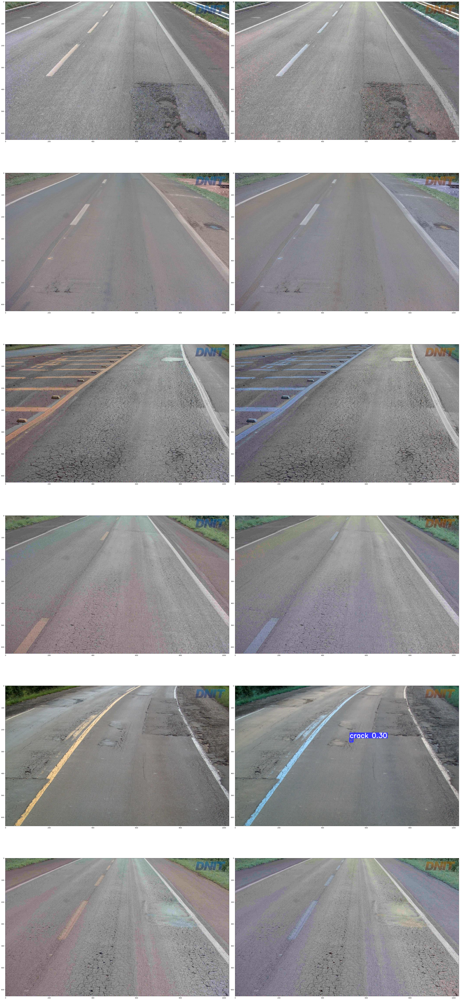

In [24]:
%matplotlib inline

test_imgs = os.listdir('./datasets/orig/test/images/')
random.shuffle(test_imgs)
imgs = test_imgs[:6]
_,axs = plt.subplots(len(imgs),2,figsize=(40,15 * len(imgs)))
predict_model = YOLO('./runs/segment/train4/weights/best.pt')
for img, ax in zip(imgs, axs):
    img_pth = os.path.join(os.path.relpath('./datasets/orig/test/images/'), img)
    I = Image.open(img_pth)
    res = predict_model.predict(img_pth)
    plotted = res[0].plot(labels=True, boxes=True, masks=True, probs=False)
    ax[0].imshow(I)
    ax[1].imshow(plotted)
    plt.sca(ax[1])
plt.tight_layout()
plt.show()